# Lecture 11 : Sobel Edge Detection

In [ ]:
# clone a public repo on Github to download some sample images
!git clone https://github.com/jasonrwilson/cmda.git

Cloning into 'cmda'...
remote: Enumerating objects: 31, done.
remote: Counting objects: 100% (31/31), done.
remote: Compressing objects: 100% (30/30), done.
remote: Total 31 (delta 8), reused 0 (delta 0), pack-reused 0
Receiving objects: 100% (31/31), 14.20 MiB | 18.72 MiB/s, done.
Resolving deltas: 100% (8/8), done.


In [ ]:
# copy the image files to our working directory
!cp cmda/*.jpg .

# Part 1 : Working with Images in Python

In [ ]:
import numpy as np # for matrix processing
from PIL import Image, ImageOps # for image processing

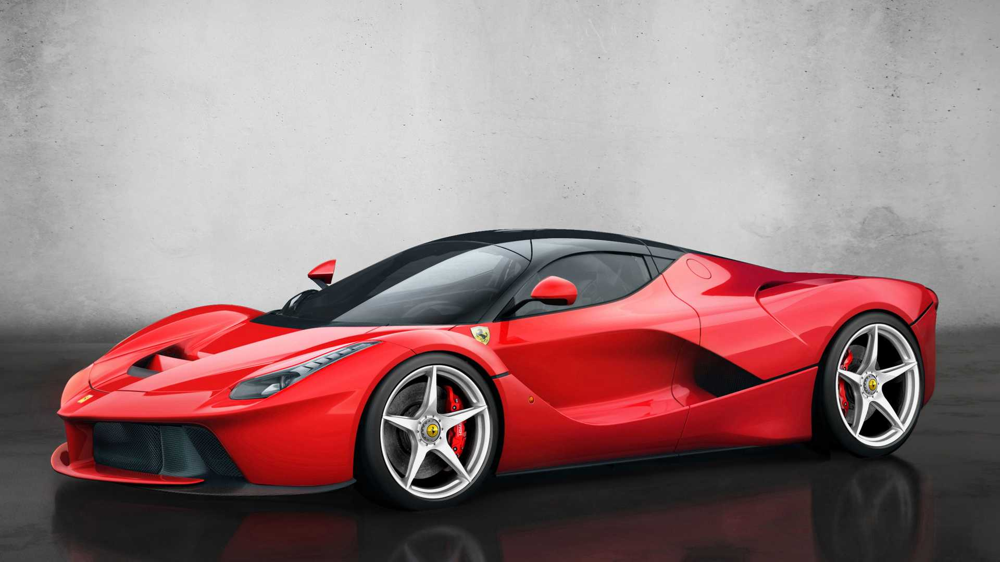

In [ ]:
car = Image.open("car.jpg")
car

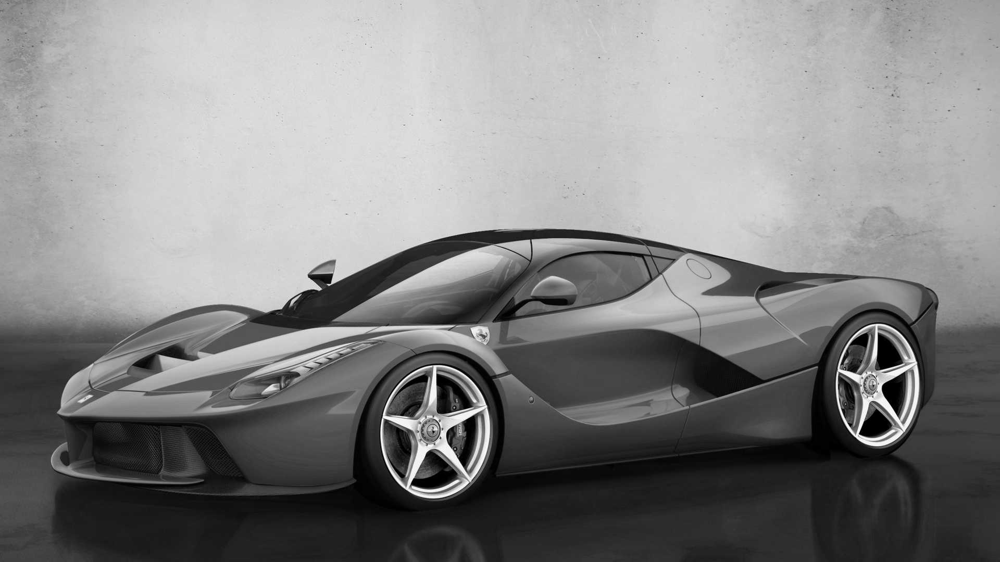

In [ ]:
grayCar = ImageOps.grayscale(car)
grayCar

In [ ]:
width,height = grayCar.size
print('grayscale car image is ',height,' pixels tall and ',width,' pixels wide.')

grayscale car image is  1080  pixels tall and  1920  pixels wide.


In [ ]:
carA = np.array(grayCar)
print (carA)

[[132 135 140 ... 154 154 154]
 [125 132 139 ... 154 154 154]
 [125 131 136 ... 155 155 155]
 ...
 [ 64  64  64 ...  42  41  41]
 [ 65  64  64 ...  41  40  40]
 [ 65  64  64 ...  40  39  39]]


In [ ]:
rows,cols = carA.shape
print ('A has ',rows,'rows and ',cols,' columns.')

A has  1080 rows and  1920  columns.


# Part 2 : Sobel Edge Detection in Python

Sobel edge detection consists of the following two kernels that we apply to each pixel in the image to detect vertical and horizontal edges.

$$\begin{bmatrix} -1 & 0 & +1 \\ -2 & 0 & +2 \\ -1 & 0 & +1 \end{bmatrix} \qquad
\begin{bmatrix} +1 & +2 & +1 \\ 0 & 0 & 0 \\ -1 & -2 & -1 \end{bmatrix}$$

Example : Apply each kernel to the center pixel of the following image matrix.

$$\begin{bmatrix} 1 & 1 & 1 \\ 0 & 0 & 0 \\ 2 & 2 & 2 \end{bmatrix}$$

We apply the first kernel which detects vertical edges:

$$G_x = (-1)(1) + 0(1) + 1(1) + (-2)(0) + 0(0) + 2(0) + (-1)(2) + 0(2) + 1(2) = 0$$

We apply the second kernel which detects horizontal edges:

$$G_y = (1)(1) + 2(1) + 1(1) + 0(0) + 0(0) + 0(0) + (-1)(2) + (-2)(2) + (-1)(2) = -4$$

To combine the results of the detectors we use the formula
$$|G| = |G_x| + |G_y| = 0 + 4 = 4$$

Given a $3 \times 3$ piece of an image matrix
$$\begin{bmatrix} P_1 & P_2 & P_3 \\ P_4 & P_5 & P_6 \\ P_7 & P_8 & P_9 \end{bmatrix}$$

we can compute value of $|G|$ at the pixel $P_5$ using the formula
$$|G| = |P_3 + 2P_6 + P_9 - P_1 - 2P_4 - P_7| + |P_1+2P_2+P_3-P_7-2P_8-P_9|$$

We will pad the perimeter of the image matrix with zeros to ensure that the above formula can be computed at each pixel.

We can threshold the value of $|G|$ to determine whether to color the pixel black (when $|G| \leq$ threshold) or
white (when $|G| > $ threshold).   


## Padding 2d Arrays in Python

In order to apply the kernel to the edges of image matrix we will need to pad the array.  We will pad with zeroes although there are other options.

Let's look at a simple example:

In [ ]:
A = np.array([[1,2,3],[4,5,6],[7,8,9]])
A_pad = np.pad(A,[1,1],'constant',constant_values = 0)
print (A,'\n')
print (A_pad)

[[1 2 3]
 [4 5 6]
 [7 8 9]] 

[[0 0 0 0 0]
 [0 1 2 3 0]
 [0 4 5 6 0]
 [0 7 8 9 0]
 [0 0 0 0 0]]


## Let's time some Python code to run the Sobel Edge detector on our car image.  

CPU times: user 34.4 s, sys: 112 ms, total: 34.5 s
Wall time: 37.5 s


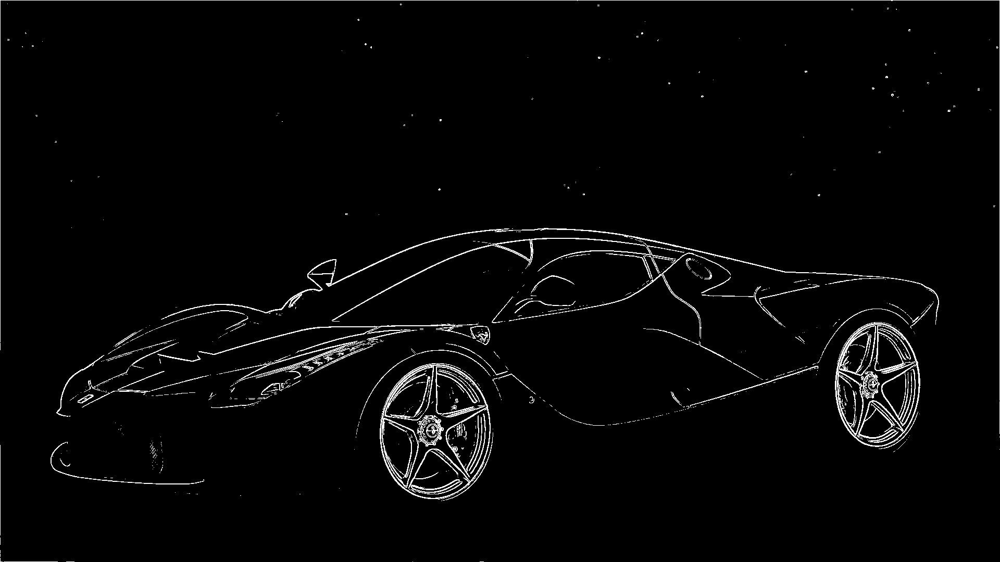

In [ ]:
%%time
threshold = 250
carA_pad = np.pad(carA,[1,1],'constant',constant_values = 0)
E = np.zeros((rows,cols),dtype='uint8')
for i in range(1,rows+1):
    for j in range(1,cols+1):
        P1 = carA_pad[i-1][j-1]
        P2 = carA_pad[i-1][j]
        P3 = carA_pad[i-1][j+1]
        P4 = carA_pad[i][j-1]
        P6 = carA_pad[i][j+1]
        P7 = carA_pad[i+1][j-1]
        P8 = carA_pad[i+1][j]
        P9 = carA_pad[i+1][j+1]
        Gx = P3+2*P6+P9-P1-2*P4-P7
        Gy = P1+2*P2+P3-P7-2*P8-P9
        size = np.abs(Gx)+np.abs(Gy)
        if (size > threshold):
            E[i-1][j-1] = 255
edges = Image.fromarray(E)
edges

# Part 3 : Putting the Python Code into a Script

## Cell based computing is only useful for small demonstrations.  

## We can combine the above Python code into a **Python script** and run it from the **command line**.

## Note that we added timing code around the nested for loop since that is where we suspect is where most of the time is being spent.  

## In order to write the file delete the \# on line 1!

In [ ]:
%%writefile sobel.py
import sys # for command line arguments
import numpy as np # for matrix processing
from PIL import Image, ImageOps # for image processing
import time # to time part of the code

# make sure command line arguments are provided
if (len(sys.argv) < 4):
    print ('command usage :',sys.argv[0],'infile','outfile','threshold')
    exit(1)
infile = sys.argv[1]
outfile = sys.argv[2]
threshold = int(sys.argv[3])

# open the input image, convert to grayscale,
# convert to a matrix, and determine the rows and cols
input = Image.open(infile)
gray = ImageOps.grayscale(input)
carA = np.array(gray).astype(np.int32)
rows,cols = carA.shape

# pad the perimeter of the image matrix with zeros
# and create the E matrix initialized to all zeros
carA_pad = np.pad(carA,[1,1],'constant',constant_values = 0)
E = np.zeros((rows,cols),dtype='uint8')

# time just the Sobel edge detector
start = time.process_time()

# Sobel Edge Detector
for i in range(1,rows+1):
    for j in range(1,cols+1):
        P1 = carA_pad[i-1][j-1]
        P2 = carA_pad[i-1][j]
        P3 = carA_pad[i-1][j+1]
        P4 = carA_pad[i][j-1]
        P6 = carA_pad[i][j+1]
        P7 = carA_pad[i+1][j-1]
        P8 = carA_pad[i+1][j]
        P9 = carA_pad[i+1][j+1]
        Gx = P3+2*P6+P9-P1-2*P4-P7
        Gy = P1+2*P2+P3-P7-2*P8-P9
        size = np.abs(Gx)+np.abs(Gy)
        if (size > threshold):
            E[i-1][j-1] = 255

# record and print elapsed time
elapsed = time.process_time()-start
print ('Time to Run The Nested For Loop Sobel Edge Detector in Python =',
        np.round(elapsed,4),'seconds')

# create the edges image
edges = Image.fromarray(E)
edges.save(outfile)

Writing sobel.py


In [ ]:
# Note what happens when we run the script without command line arguments.
!python3 sobel.py

command usage : sobel.py infile outfile threshold


In [ ]:
# Let's run the command with arguments and time it using the Linux time command.
!time python3 sobel.py car.jpg car_edges_python.jpg 250

Time to Run The Nested For Loop Sobel Edge Detector in Python = 29.3073 seconds

real	0m29.909s
user	0m29.556s
sys	0m0.149s


## Almost all of the runtime is being spent in the nested for loop!

# Part 4 : Writing the nested for loop in C

## The C **source code** below contains the function *sobel* that implements the nested for loop.

In [ ]:
%%writefile sobel.c
#include <stdio.h>
#include <stdlib.h>
#include <time.h>

typedef unsigned char byte;

void sobel(byte A_pad[], byte E[], int rows, int cols, int threshold) {

    clock_t begin = clock();

    // Add code here to implement the Sobel edge detector

    clock_t end = clock();
    double time_spent = (double)(end - begin) / CLOCKS_PER_SEC;
    printf ("Time to Run Nested For Loop Sobel Edge Detector in C = %.6lf seconds\n",
            time_spent);
}

Writing sobel.c


## The above C code only performs the nested loop Sobel calculations!  

## It does not read the .jpg image, convert it to a matrix, and print the resulting .jpg edge matrix.  

## In fact, it would be tricky to write C code to handle working with the .jpg files.  

## However, the Python script was plenty fast for everything except the nested for loop.

## Let's use C for the brute force calculation of the nested for loop and Python for everything else!

In [ ]:
# Use the C compiler to create a shared object file for our sobel function.
!gcc -O3 -march=native -fPIC -shared -o sobel.so sobel.c

# Part 5 : Modifying the Sobel Python script to call the C function.


In [ ]:
%%writefile c_sobel.py
import sys # for command line arguments
import numpy as np # for matrix processing
from PIL import Image, ImageOps # for image processing
import ctypes as ct # for calling C from Python
lib = ct.cdll.LoadLibrary("./sobel.so") # load C sobel edge detector

# make sure command line arguments are provided
if (len(sys.argv) < 4):
    print ('command usage :',sys.argv[0],'infile','outfile','threshold')
    exit(1)
infile = sys.argv[1]
outfile = sys.argv[2]
threshold = int(sys.argv[3])

# open the input image, convert to grayscale,
# convert to a matrix, and determine the rows and cols
input = Image.open(infile)
gray = ImageOps.grayscale(input)
A = np.array(gray)
rows,cols = A.shape

# pad the perimeter of the image matrix with zeros
# and create the E matrix initialized to all zeros
A_pad = np.pad(A,[1,1],'constant',constant_values = 0)
E = np.zeros((rows,cols),dtype='uint8')

# call the C sobel edge detector
A_pad_cptr = A_pad.ctypes.data_as(ct.POINTER(ct.c_uint8))
E_cptr = E.ctypes.data_as(ct.POINTER(ct.c_uint8))
lib.sobel(A_pad_cptr,E_cptr,ct.c_int(rows),ct.c_int(cols),ct.c_int(threshold))

# create the edges image
edges = Image.fromarray(E)
edges.save(outfile)

Writing c_sobel.py


In [ ]:
# Let's run the Python script that calls the C function to handle the nested for loop
!time python3 c_sobel.py car.jpg car_edges_c.jpg 250

Time to Run Nested For Loop Sobel Edge Detector in C = 0.000003 seconds

real	0m0.393s
user	0m0.306s
sys	0m0.176s


In [ ]:
# Let's make sure the combined Python/C code actually produced the correct edges!
!diff car_edges_c.jpg car_edges_key.jpg

Binary files car_edges_c.jpg and car_edges_key.jpg differ


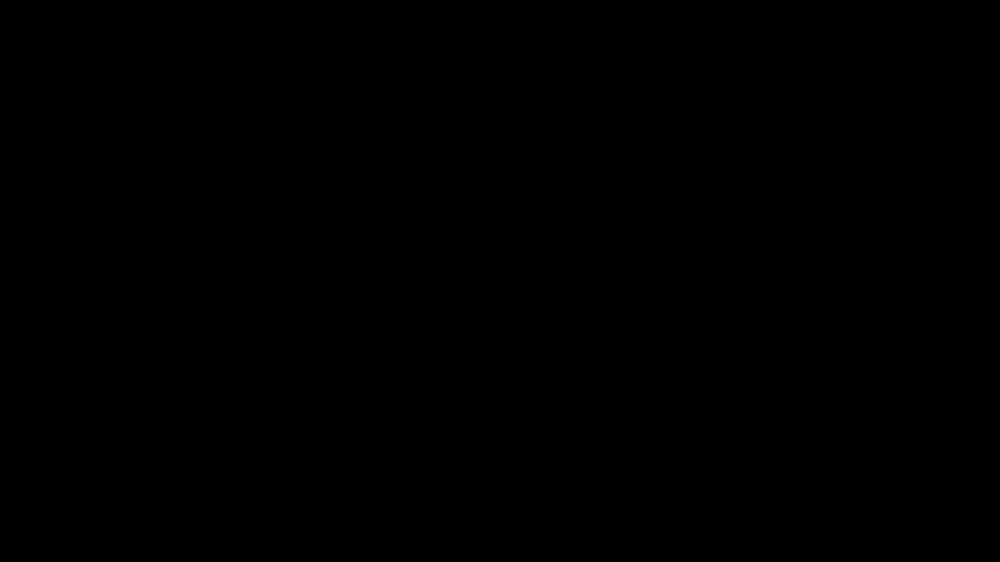

In [ ]:
car_edges_c = Image.open("car_edges_c.jpg")
car_edges_c

# C Speedup

## How many times faster does the nested for loop run in C versus Python?

$$\text{speedup} = \frac{\text{Time to Run Nested For Loop in Python}}{\text{Time to Run Nested For Loop in C}} = $$

# Part 6 : Running Sobel on a satellite image

## Let's run Sobel on an image with 8 million pixels.

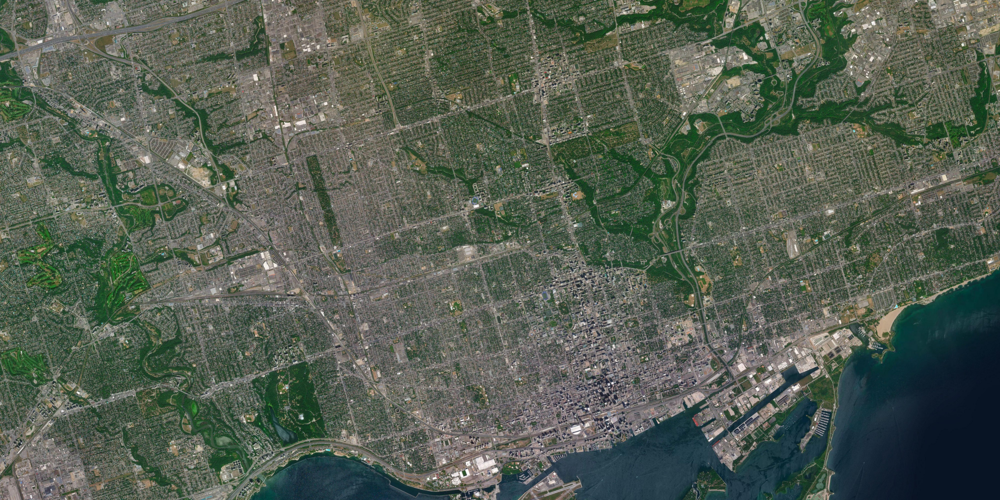

In [ ]:
satimage = Image.open("satimage.jpg")
satimage

In [ ]:
width,height = satimage.size
print('satellite image is ',height,' pixels tall and ',width,' pixels wide.')

satellite image is  2000  pixels tall and  4000  pixels wide.


In [ ]:
# Run the Python/C script on the satellite image
!time python3 c_sobel.py satimage.jpg sat_edges.jpg 250

Time to Run Nested For Loop Sobel Edge Detector in C = 0.000002 seconds

real	0m0.633s
user	0m0.414s
sys	0m0.149s


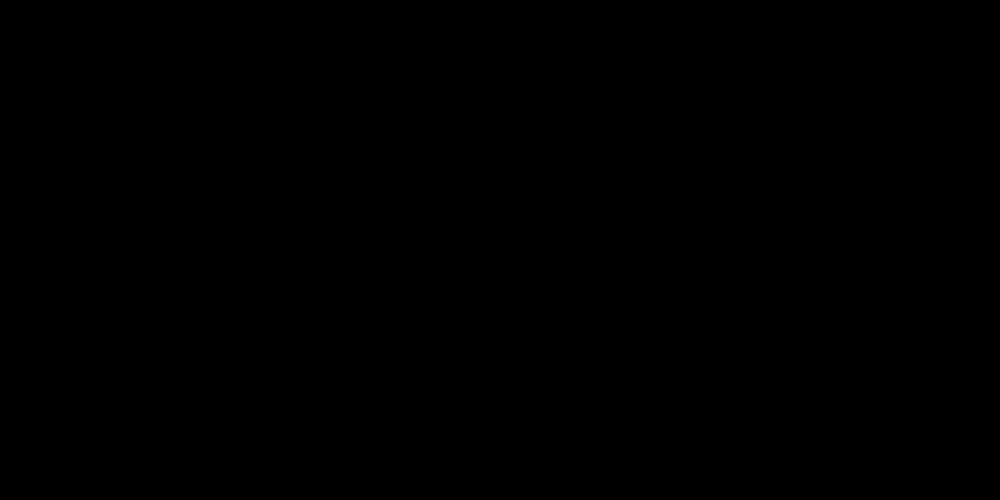

In [ ]:
sat_edges = Image.open("sat_edges.jpg")
sat_edges